# library imports

In [1]:
import geopandas as gpd
import shapely
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px

# read .shp HA district mappings

In [2]:
district_dcca = pd.read_excel("../raw_data/SDI_2006_spatial map.xlsx",
                             engine = "openpyxl")

In [3]:
district_dcca.columns.values

array(['Districtcode', 'Districtname', 'Districtboard', 'Districtarea',
       'Merge', 'Constituency0', 'Constituency1', 'Constituency2',
       'Constituency3', 'Constituency4', 'Constituency5', 'Constituency6',
       'Constituency7', 'Constituency8', 'Constituency9',
       'Constituency10', 'Constituency11', 'Constituency12',
       'Constituency13', 'Constituency14', 'Constituency15',
       'Constituency16', 'Constituency17', 'Constituency18',
       'Constituency19', 'Constituency20', 'Constituency21',
       'Constituency22', 'Constituency23', 'Constituency24',
       'Constituency25', 'Constituency26'], dtype=object)

In [4]:
district_dcca = pd.wide_to_long(district_dcca.drop(district_dcca.columns[2:5], axis = 1), 
                                stubnames='Constituency', 
                                i=['Districtcode', "Districtname"], 
                                j = "dcca_rank").dropna()

In [5]:
# collapse same-constituency HA districts
df = district_dcca.groupby(["Districtname"])["Constituency"].apply(list).apply(" ".join).reset_index()
df = df.groupby("Constituency")["Districtname"].apply(list)
df = df.reset_index()
df.head()

,Constituency,Districtname
0,A01,"[ADMIRALTY, CENTRAL]"
1,A02 A03,[MID-LEVEL]
2,A04,[PEAK]
3,A05,[M-LEVEL WEST]
4,A06,"[GREEN ISLAND, MOUNT DAVIS]"


In [6]:
# make dictionary of same-constituency HA districts
ha_dcca03_dict = df[df["Districtname"].str.len() > 1].reset_index()

In [7]:
ha_dcca03_dict["district"] = ha_dcca03_dict["Districtname"].str[0]

In [8]:
ha_dcca03_dict.head()

,index,Constituency,Districtname,district
0,0,A01,"[ADMIRALTY, CENTRAL]",ADMIRALTY
1,4,A06,"[GREEN ISLAND, MOUNT DAVIS]",GREEN ISLAND
2,26,D11 D12,"[CYBER PORT, POKFULAM, SANDY BAY]",CYBER PORT
3,28,D16,"[CHUNG HOM KOK, DEEP WATER BAY, NAM LONG SHAN,...",CHUNG HOM KOK
4,29,D17,"[SHEK O, STANLEY, TAI TAM]",SHEK O


In [9]:
# save dictionary as xlsx
ha_dcca03_dict.to_excel("ha_dcca03_dict.xlsx")

In [10]:
df["Districtname"] = df["Districtname"].str[0]

In [11]:
# left-join constituency to df
district_dcca = pd.read_excel("../raw_data/SDI_2006_spatial map.xlsx",
                             engine = "openpyxl")
district_dcca = pd.wide_to_long(district_dcca.drop(district_dcca.columns[2:5], axis = 1), 
                                stubnames='Constituency', 
                                i=['Districtcode', "Districtname"], 
                                j = "dcca_rank").dropna()

district_dcca = district_dcca.reset_index()

In [12]:
district_dcca = district_dcca.drop("dcca_rank", axis = 1)

In [13]:
district_dcca.head()

,Districtcode,Districtname,Constituency
0,ABD,ABERDEEN,D01
1,ABD,ABERDEEN,D08
2,ABD,ABERDEEN,D13
3,ABD,ABERDEEN,D14
4,ADMI,ADMIRALTY,A01


In [14]:
df.head()

,Constituency,Districtname
0,A01,ADMIRALTY
1,A02 A03,MID-LEVEL
2,A04,PEAK
3,A05,M-LEVEL WEST
4,A06,GREEN ISLAND


In [15]:
df = df.merge(district_dcca, 
         left_on = "Districtname", 
         right_on = "Districtname")

In [16]:
df.head()

,Constituency_x,Districtname,Districtcode,Constituency_y
0,A01,ADMIRALTY,ADMI,A01
1,A02 A03,MID-LEVEL,MLV,A02
2,A02 A03,MID-LEVEL,MLV,A03
3,A04,PEAK,PEAK,A04
4,A05,M-LEVEL WEST,MLVW,A05


In [17]:
df = df.iloc[:, 1:]

In [18]:
df = df.rename(columns = {"Constituency_y": "Constituency"})

In [19]:
district_dcca = df

In [20]:
district_dcca.head()

,Districtname,Districtcode,Constituency
0,ADMIRALTY,ADMI,A01
1,MID-LEVEL,MLV,A02
2,MID-LEVEL,MLV,A03
3,PEAK,PEAK,A04
4,M-LEVEL WEST,MLVW,A05


# read .shp DCCA data

In [21]:
# https://accessinfo.hk/en/request/shapefile_for_1999_2003_2007_dis
dcca_gpd = gpd.read_file("../raw_data/DCCA2003_SHP/DCCA2003.shp")

In [22]:
dcca_gpd.head()

,AREA,PERIMETER,DCCA2003_,DCCA2003_I,CACODE,ENAME,CNAME,geometry
0,1.330686e+08,70775.817069,2,284,N14,Sha Ta,沙打,"POLYGON ((834243.595 846329.123, 834268.239 84..."
1,1.021801e+08,71598.669202,3,301,P18,Shuen Wan,船灣,"POLYGON ((852652.915 847596.316, 862714.000 84..."
2,1.766725e+08,71668.244423,4,393,P19,Sai Kung North,西貢北,"POLYGON ((862846.630 846816.501, 864894.000 84..."
3,2.582735e+07,29845.945789,5,275,N08,Sheung Shui Rural,上水鄉郊,"POLYGON ((826724.722 842314.280, 826783.432 84..."
4,1.648465e+07,23875.603000,6,282,N16,Queen's Hill,皇后山,"POLYGON ((832294.221 841838.634, 832304.241 84..."


In [23]:
dcca_gpd[dcca_gpd["CACODE"] == "T08"]

,AREA,PERIMETER,DCCA2003_,DCCA2003_I,CACODE,ENAME,CNAME,geometry
398,8.874241e+06,13738.515864,400,392,T08,Cheung Chau North,長洲北,"POLYGON ((821753.879 810701.203, 822823.510 80..."


In [24]:
dcca_gpd = dcca_gpd.drop(dcca_gpd.columns[:4], axis = 1)

In [25]:
dcca_gpd.columns.values

array(['CACODE', 'ENAME', 'CNAME', 'geometry'], dtype=object)

In [26]:
dcca_gpd.head()

,CACODE,ENAME,CNAME,geometry
0,N14,Sha Ta,沙打,"POLYGON ((834243.595 846329.123, 834268.239 84..."
1,P18,Shuen Wan,船灣,"POLYGON ((852652.915 847596.316, 862714.000 84..."
2,P19,Sai Kung North,西貢北,"POLYGON ((862846.630 846816.501, 864894.000 84..."
3,N08,Sheung Shui Rural,上水鄉郊,"POLYGON ((826724.722 842314.280, 826783.432 84..."
4,N16,Queen's Hill,皇后山,"POLYGON ((832294.221 841838.634, 832304.241 84..."


# joining HA district and dcca geometry info

In [27]:
# left-join dcca_gpd to district_dcca by cacode -> constituency
district_gpd = district_dcca.merge(dcca_gpd, left_on = "Constituency", right_on = "CACODE")

In [28]:
district_gpd.head()

,Districtname,Districtcode,Constituency,CACODE,ENAME,CNAME,geometry
0,ADMIRALTY,ADMI,A01,A01,Chung Wan,中環,"POLYGON ((835295.787 816861.366, 835295.341 81..."
1,MID-LEVEL,MLV,A02,A02,Mid Levels East,半山東,"POLYGON ((833624.850 816059.360, 833686.787 81..."
2,MID-LEVEL,MLV,A03,A03,Castle Road,衛城,"POLYGON ((833022.030 816107.900, 833038.830 81..."
3,PEAK,PEAK,A04,A04,Peak,山頂,"POLYGON ((833687.541 815330.876, 833688.540 81..."
4,M-LEVEL WEST,MLVW,A05,A05,University,大學,"POLYGON ((832533.390 816145.730, 832562.900 81..."


In [29]:
# convert to lat long system
district_gpd["geometry"] = gpd.GeoSeries(district_gpd["geometry"]).set_crs('EPSG:2326').to_crs("EPSG:4326")

In [30]:
from shapely.ops import cascaded_union

# map 

In [31]:
# group by districtcode, union the geometry
unionised_district_gpd = district_gpd.groupby("Districtcode").apply(lambda x: cascaded_union(x["geometry"]))

/var/folders/qj/hf26mvwj06q4f45ybdkdprgw0000gn/T/ipykernel_4902/1671950625.py:2: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.
  unionised_district_gpd = district_gpd.groupby("Districtcode").apply(lambda x: cascaded_union(x["geometry"]))
/Users/ytf1997/miniconda3/envs/ML_learn/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:1983: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  result[:] = values


In [32]:
unionised_district_gpd=unionised_district_gpd.to_frame().reset_index()

In [33]:
unionised_district_gpd.head()

,Districtcode,0
0,ABD,POLYGON ((114.16417544781659 22.24543323752824...
1,ADMI,POLYGON ((114.16744001280681 22.29065869840450...
2,ALC,POLYGON ((114.15906302096612 22.24215030661385...
3,CC,"POLYGON ((114.04642045938526 22.1895771005187,..."
4,CH,POLYGON ((114.20510483392614 22.33776809702194...


In [34]:
unionised_district_gpd=unionised_district_gpd.rename(columns = {0: "geometry"})

In [35]:
unionised_district_gpd = unionised_district_gpd.merge(district_gpd[["Districtcode", "Districtname"]], 
                                                      left_on = "Districtcode",
                                                     right_on = "Districtcode")

In [36]:
district_gpd = unionised_district_gpd

In [37]:
district_gpd = district_gpd.drop_duplicates(subset = ["Districtcode"]).reset_index(drop = True)

# read .shp land use raw data

In [38]:
zone_gpd = gpd.read_file("../raw_data/Hong_Kong_Outline_Zoning_Plans_Land_Use_Zonings_/Hong_Kong_Outline_Zoning_Plans_Land_Use_Zonings_.shp")

In [39]:
# check coordinates system of zone_gpd
gpd.GeoSeries(zone_gpd["geometry"]).crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [40]:
print([s for s in zone_gpd["DESC_ENG"].unique() if "Park" in s])
print([s for s in zone_gpd["DESC_ENG"].unique() if "Industrial" in s])
print([s for s in zone_gpd["DESC_ENG"].unique() if "Road" in s])

['Country Park']
['Industrial', 'Industrial (Group D)', 'Industrial (3)', 'Industrial (1)', 'Industrial (2)']
['Major Road and Junction']


In [41]:
# road_gpd = zone_gpd[zone_gpd.DESC_ENG.str.contains("Road")]

# union "geometry" by districtcode

# plotly 

In [42]:
px.set_mapbox_access_token(open("./mapbox_token").read())

In [43]:
import plotly.express as px

In [44]:
district_gpd_shortlist = district_gpd.reset_index()[
    district_gpd.reset_index()["Districtname"] == "CHI MA WAN"
]

In [45]:
df = district_gpd
df = df.set_index('Districtname')

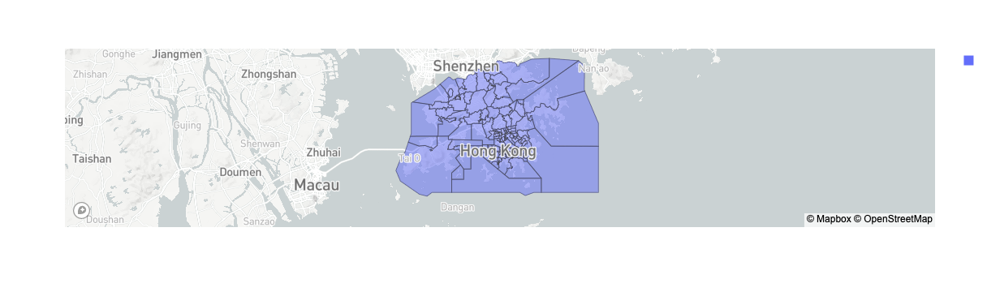

In [46]:
fig = px.choropleth_mapbox(df,
                           geojson=gpd.GeoSeries(df.geometry),
                           locations=df.index,
                           center={"lat": 22.3193, "lon": 114.1694},
                          mapbox_style="light",
                          opacity = .5)
fig.show()

In [342]:
# save as html
# fig.write_html("district_map.html")

# data clearning

In [47]:
def find_land_use(district, shape_gpd):
    """
    return cutout polygons, cutout area of intersecting zones and road zones, 
    as well as district area and total zoned/planned area within a district using zone map 
    provided by HK Govt
    
        Parameters:
            district (shapely.geometry.Polygon): polygon of a district
            shape_gpd (pd.DataFrame): dataframe containing planned zones 
            in shapely.geometry.Polygon inside a column named "geometry"
        
        Returns:
            cutouts ([shapely.geometry.Polygon]): list of polygons of road zones intersecting
            with district
            cutout.area (double): union area of cutouts
            district.area (double): district area
            zoned (Polygon): union polygon all planned zones within the district
    
    """
    cutouts = []
    cutout = shape_gpd["geometry"][0]
    zoned = shape_gpd["geometry"][0]
    for i in range(1,len(shape_gpd["geometry"])):
        if district.intersects(shape_gpd["geometry"][i]):
            intersect = district.intersection(shape_gpd["geometry"][i])
            zoned = zoned.union(intersect)
            if "Road" in shape_gpd["DESC_ENG"][i]:
                pg = shape_gpd["geometry"][i]
                intersect = district.intersection(pg)
                cutouts.append(intersect)
                cutout = cutout.union(intersect)
                
    # zoned_area = zoned.area
        
    return (cutouts, cutout.area, district.area, zoned)

ABD ABERDEEN Road over zoned area % 0.06547089284877966


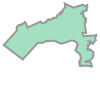

In [48]:
# print(district_gpd["Districtcode"][0], district_gpd["Districtname"][0])
i = 0
(cutouts, cutout_area, district_area, zoned) = find_land_use(district_gpd["geometry"][i], zone_gpd)
print(district_gpd["Districtcode"][i], 
      district_gpd["Districtname"][i],
      "Road over zoned area %",
      cutout_area / zoned.area)
district_gpd["geometry"][i]

In [49]:
df = district_gpd
road_over_zoned = []
for i in range(len(df)):
    # print(i)
    if i % 10 == 0:
        print(f"Finished {i} HA districts")
    cutouts, road, circle, zoned = find_land_use(df["geometry"][i], zone_gpd)
    
    # print(road / zoned, type(road_over_zoned))
    if zoned.area == 0 or road / zoned.area == 0:
        road_over_zoned.append(-1)
    else:
        road_over_zoned.append(road / zoned.area)


Finished 0 HA districts
Finished 10 HA districts
Finished 20 HA districts
Finished 30 HA districts
Finished 40 HA districts
Finished 50 HA districts
Finished 60 HA districts
Finished 70 HA districts
Finished 80 HA districts
Finished 90 HA districts
Finished 100 HA districts
Finished 110 HA districts


In [50]:
len(road_over_zoned)

118

# merging with HA district df

In [51]:
df = district_gpd
df = pd.concat([df, pd.DataFrame({"road_over_zoned": road_over_zoned})], axis = 1)
df["road_over_zoned"] = round(df["road_over_zoned"], 3)

In [52]:
# df = df[df["road_over_zoned"] != -1]

In [53]:
df = df.set_index("Districtname")

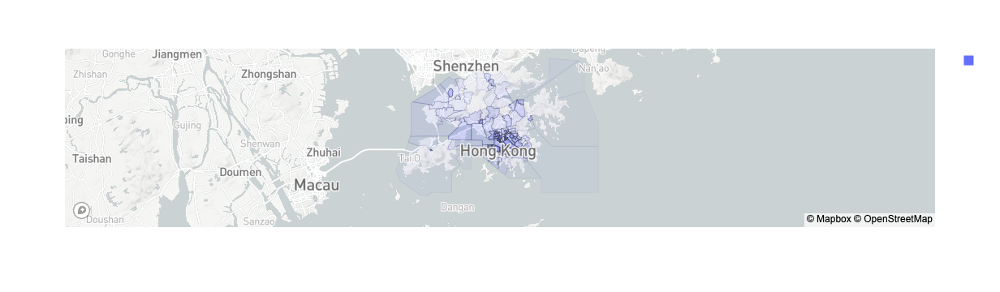

In [54]:
fig = px.choropleth_mapbox(df,
                           geojson=gpd.GeoSeries(df.geometry),
                           locations=df.index,
                           center={"lat": 22.3193, "lon": 114.1694},
                          mapbox_style="light",
                          opacity = df.road_over_zoned / max(df.road_over_zoned))
fig.show()

In [55]:
df.to_excel("ha_district_road_over_zoned.xlsx")

# asthma prev by region

In [65]:
asthma = pd.read_csv("../raw_data/cardiac_arrest.prev.regional.csv", 
                     index_col=0)
asthma = asthma.reset_index(drop = True)
asthma = asthma.rename(columns = {"District.of.Residence.Description": "district"})

In [66]:
asthma.head()

,district,n,total,prevalence
0,ABERDEEN,93,7231.0,0.012861
1,ADMIRALTY,1,19.0,0.052632
2,AP LEI CHAU,81,7430.0,0.010902
3,CAUSEWAY BAY,68,2364.0,0.028765
4,CENTRAL,16,998.0,0.016032


In [67]:
for i in range(len(asthma)):
    for j in range(len(ha_dcca03_dict)):
        for districtname in ha_dcca03_dict["Districtname"][j]:
            if asthma["district"][i] == districtname:
                asthma["district"][i] = ha_dcca03_dict["district"][j]

/var/folders/qj/hf26mvwj06q4f45ybdkdprgw0000gn/T/ipykernel_4902/535072086.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [68]:
asthma.district.unique().__len__()

115

In [70]:
asthma = asthma.groupby("district").aggregate({"n": sum, 
                               "total": sum})
asthma["prev"] = asthma["n"] / asthma["total"]

# merging with district map and road over zoned area %

In [71]:
df = district_gpd
df = pd.concat([df, pd.DataFrame({"road_over_zoned": road_over_zoned})], axis = 1)
df["road_over_zoned"] = round(df["road_over_zoned"], 3)
df = df.merge(asthma, how = "left", left_on = "Districtname", right_on = "district")

In [72]:
df.tail()

/Users/ytf1997/miniconda3/envs/ML_learn/lib/python3.10/site-packages/pandas/core/dtypes/inference.py:383: ShapelyDeprecationWarning:

Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.

/Users/ytf1997/miniconda3/envs/ML_learn/lib/python3.10/site-packages/pandas/core/dtypes/inference.py:384: ShapelyDeprecationWarning:

__len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.

/Users/ytf1997/miniconda3/envs/ML_learn/lib/python3.10/site-packages/pandas/io/formats/printing.py:117: ShapelyDeprecationWarning:

Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.

/Users/ytf1997/miniconda3/envs/ML_learn/lib/python3.10/site-packages/p

,Districtcode,geometry,Districtname,road_over_zoned,n,total,prev
113,WTS,POLYGON ((114.19610933685264 22.33831576660647...,WONG TAI SIN,0.232,344.0,6540.0,0.052599
114,WYT,"POLYGON ((114.3361895686625 22.56813109713753,...",WONG YUE TAN,0.028,5.0,541.0,0.009242
115,YL,(POLYGON ((114.03502962996073 22.4434140566542...,YUEN LONG,0.055,1207.0,45123.0,0.026749
116,YMT,POLYGON ((114.17066871333765 22.31298979120381...,YAU MA TEI,0.505,217.0,9035.0,0.024018
117,YYT,POLYGON ((114.16923076173643 22.33683294855551...,YAU YAT TSUEN,0.159,41.0,1305.0,0.031418


In [73]:
# df = df[df["prev"] < 0.015]

In [84]:
df["per_100"] = round(df["prev"] * 100, 3)

/var/folders/qj/hf26mvwj06q4f45ybdkdprgw0000gn/T/ipykernel_4902/3465543817.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [81]:
df = df[df["total"] >= 2500]

Text(0.5, 1.0, '2015-2021 regional cardiac arrest prevalence vs. road area percentage')

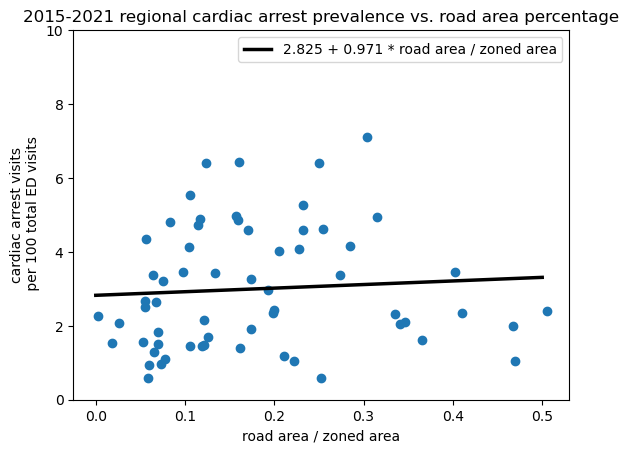

In [85]:
plt.scatter(df.road_over_zoned, df.per_100)
plt.ylim(top = 10, bottom = 0)
import numpy as np
idx = np.isfinite(df.road_over_zoned) & np.isfinite(df.per_100)
b, a = np.polyfit(df.road_over_zoned[idx], df.per_100[idx], deg=1)

# Create sequence of 100 numbers from 0 to .4
xseq = np.linspace(0, .5, num=100)

# Plot regression line
plt.plot(xseq, a + b * xseq, color="k", lw=2.5, 
         label = f"{round(a, 3)} + {round(b, 3)} * road area / zoned area")
plt.legend()
plt.xlabel("road area / zoned area")
plt.ylabel("cardiac arrest visits\n per 100 total ED visits")
plt.title("2015-2021 regional cardiac arrest prevalence vs. road area percentage")
# \n Region with total ED visits >= 2500 only")

In [87]:
len(df)

62

# plotly dashboard

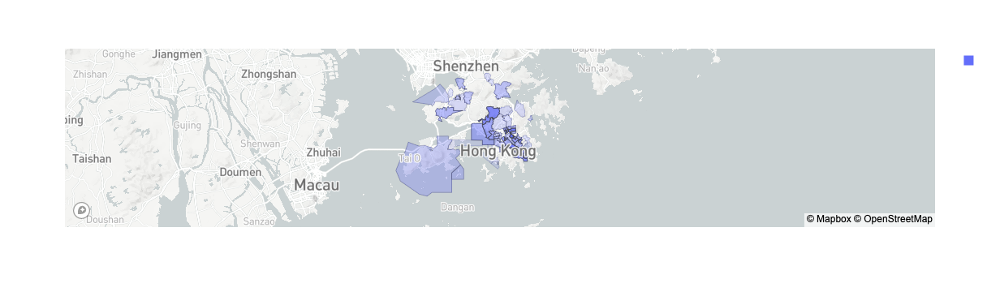

In [86]:
# fig2 = px.scatter_mapbox(df, 
#                      geojson = df.geometry,
#                      hover_name="Districtname",
#                         )
map_df = df.set_index("Districtname")
fig2 = px.choropleth_mapbox(map_df,
                           geojson=gpd.GeoSeries(map_df.geometry),
                            hover_data = ["road_over_zoned", "per_100"],
                           locations=map_df.index,
                            
                           center={"lat": 22.3193, "lon": 114.1694},
                          mapbox_style="light",
                          opacity = map_df.per_100 / max(map_df.per_100))
fig2.show()

In [91]:
fig2.write_html("ha_district_cardiac_arrest.html")